<a href="https://colab.research.google.com/github/mantra0519/Retail_store_analysis/blob/main/dog_vision.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
# !unzip "drive/My Drive/dog vision/dog-breed-identification.zip" -d "drive/My Drive/dog vision/"

In [1]:
%cd /content/drive/MyDrive/dog\ vision



/content/drive/MyDrive/dog vision


In [2]:
!git config user.name "mantra0519"
!git config user.email "mantra19aug@gmail.com"


fatal: not in a git directory
fatal: not in a git directory


# 🐶 End-to-end Multil-class Dog Breed Classification

This notebook builds an end-to-end multi-class image classifier using TensorFlow 2.x and TensorFlow Hub.


## 1. Problem
Identifying the breed of a dog given an image of a dog.

When I'm sitting at the cafe and I take a photo of a dog, I want to know what breed of dog it is.

## 2. Data
The data we're using is from Kaggle's dog breed identification competition.

https://www.kaggle.com/c/dog-breed-identification/data

## 3. Evaluation
The evaluation is a file with prediction probabilities for each dog breed of each test image.

https://www.kaggle.com/c/dog-breed-identification/overview/evaluation

## 4. Features

Some information about the data:

We're dealing with images (unstructured data) so it's probably best we use deep learning/transfer learning.
There are 120 breeds of dogs (this means there are 120 different classes).
There are around 10,000+ images in the training set (these images have labels).
There are around 10,000+ images in the test set (these images have no labels, because we'll want to predict them).


In [2]:
1+2

3

In [3]:
1+2

3

In [4]:
# Source - https://stackoverflow.com/a
# Posted by Dmitry543
# Retrieved 2025-11-27, License - CC BY-SA 4.0

!pip install tensorflow
!pip install keras
!pip install tensorflow-hub>=0.16


In [5]:
# !pip install tf-keras
# !pip install keras
# After running these, you MUST restart your Colab runtime (Runtime -> Restart runtime)

In [6]:
import tensorflow as tf
import tensorflow_hub as hub
from tensorflow.keras import layers

print("tf version", tf.__version__)

tf version 2.19.0


In [7]:

# Run this cell if TensorFlow 2.x isn't the default in Colab
try:
  # %tensorflow_version only exists in Colab
  %tensorflow_version 2.x
except Exception:
  pass

Colab only includes TensorFlow 2.x; %tensorflow_version has no effect.


In [8]:
# !pip install --upgrade tensorflow-hub

In [9]:
# Import necessary tools
import tensorflow as tf
import tensorflow_hub as hub

print("TF version:", tf.__version__)
print("TF Hub version:", hub.__version__)
# print("keras Hub version:", keras.__version__)
# Check for GPU availability
print("GPU", "available (YESSSS!!!!!)" if tf.config.list_physical_devices("GPU") else "not available :(")

TF version: 2.19.0
TF Hub version: 0.16.1
GPU available (YESSSS!!!!!)


In [10]:
# turning our images into numerical represnetation


# checkout the labels for the data

In [11]:
import pandas as pd
labels_csv= pd.read_csv("drive/MyDrive/dog vision/labels.csv")

In [12]:
print(labels_csv.describe())
print(labels_csv.head())

                                      id               breed
count                              10222               10222
unique                             10222                 120
top     fff43b07992508bc822f33d8ffd902ae  scottish_deerhound
freq                                   1                 126
                                 id             breed
0  000bec180eb18c7604dcecc8fe0dba07       boston_bull
1  001513dfcb2ffafc82cccf4d8bbaba97             dingo
2  001cdf01b096e06d78e9e5112d419397          pekinese
3  00214f311d5d2247d5dfe4fe24b2303d          bluetick
4  0021f9ceb3235effd7fcde7f7538ed62  golden_retriever


In [13]:
labels_csv.head()

,id,breed
0,000bec180eb18c7604dcecc8fe0dba07,boston_bull
1,001513dfcb2ffafc82cccf4d8bbaba97,dingo
2,001cdf01b096e06d78e9e5112d419397,pekinese
3,00214f311d5d2247d5dfe4fe24b2303d,bluetick
4,0021f9ceb3235effd7fcde7f7538ed62,golden_retriever


In [14]:
# how many number of dog breeds we have of each

<Axes: xlabel='breed'>

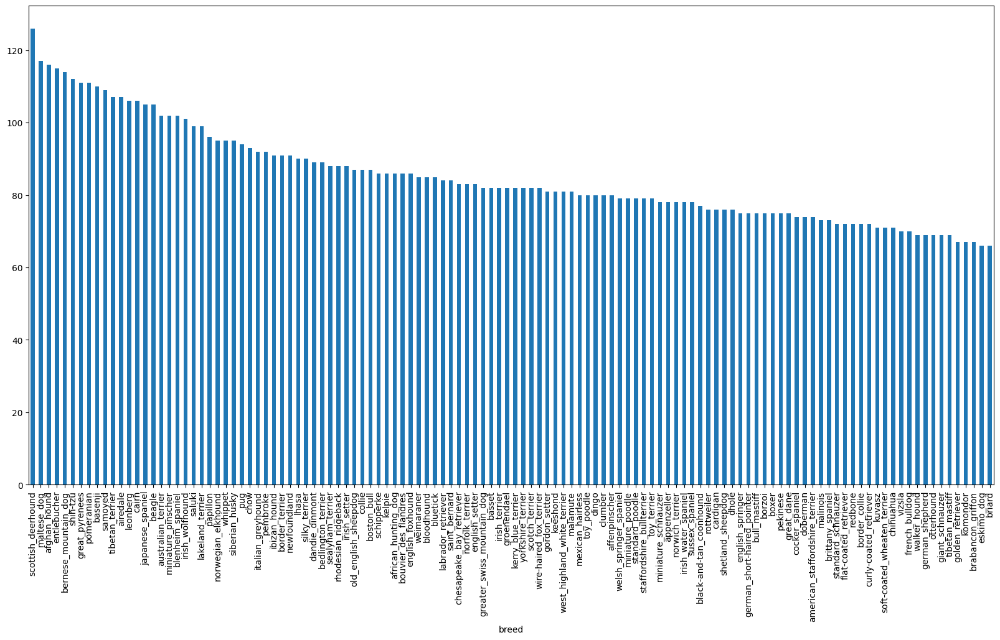

In [15]:
labels_csv["breed"].value_counts().plot.bar(figsize= (20,10))

In [16]:
labels_csv["breed"].value_counts().median()

82.0

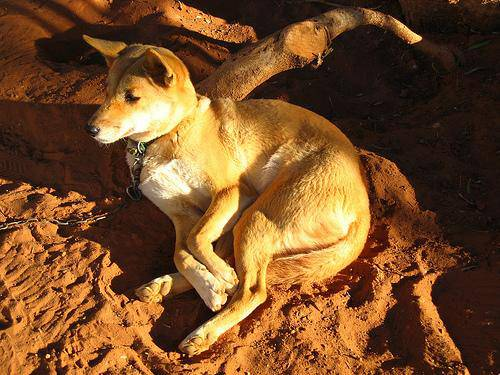

In [17]:
# Let's view an image
from IPython.display import Image
Image("drive/My Drive/dog vision/train/001513dfcb2ffafc82cccf4d8bbaba97.jpg")

In [18]:
#create pathnames from the image id
filenames= []
for fnames in labels_csv['id']:
    filenames.append("drive/My Drive/dog vision/train/" + fnames+ ".jpg")
filenames[:10]

['drive/My Drive/dog vision/train/000bec180eb18c7604dcecc8fe0dba07.jpg',
 'drive/My Drive/dog vision/train/001513dfcb2ffafc82cccf4d8bbaba97.jpg',
 'drive/My Drive/dog vision/train/001cdf01b096e06d78e9e5112d419397.jpg',
 'drive/My Drive/dog vision/train/00214f311d5d2247d5dfe4fe24b2303d.jpg',
 'drive/My Drive/dog vision/train/0021f9ceb3235effd7fcde7f7538ed62.jpg',
 'drive/My Drive/dog vision/train/002211c81b498ef88e1b40b9abf84e1d.jpg',
 'drive/My Drive/dog vision/train/00290d3e1fdd27226ba27a8ce248ce85.jpg',
 'drive/My Drive/dog vision/train/002a283a315af96eaea0e28e7163b21b.jpg',
 'drive/My Drive/dog vision/train/003df8b8a8b05244b1d920bb6cf451f9.jpg',
 'drive/My Drive/dog vision/train/0042188c895a2f14ef64a918ed9c7b64.jpg']

os.listdir - the os.listdir() function in Python's os module is used to get the list of all files and directories in the specified path. If no path is specified, it returns the list of files and directories in the current working directory. It returns the list in an arbitrary order.

In [19]:
# we want to make sure tht we are working with the sam eamount of data
# check whether number of filnames matches number of actual image files
import os
if len(os.listdir("drive/My Drive/dog vision/train/")) == len(filenames):
  print("filenmaes match actual amount of filenames!! proceed.")
else:
  print("didnt match")

filenmaes match actual amount of filenames!! proceed.


In [20]:
len(filenames)

10222

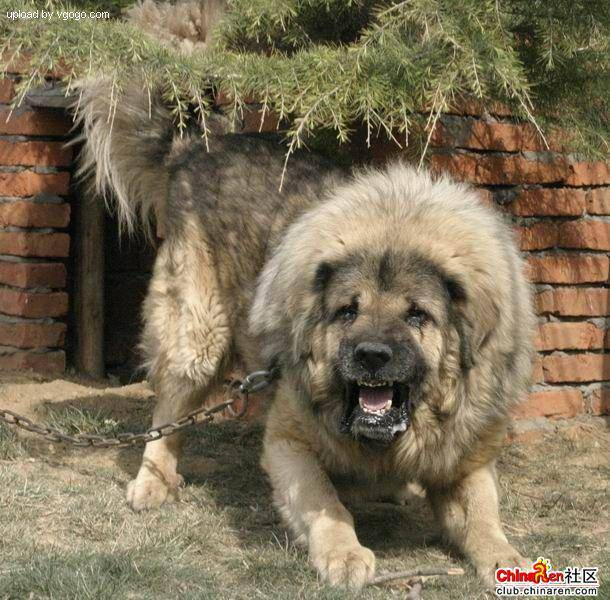

In [21]:
#one more check
Image(filenames[9000])

In [22]:
labels_csv['breed'][9000]

'tibetan_mastiff'

since we have now got our training image filepaths in a list , lets prepare our labels

In [23]:
import numpy as np
labels= labels_csv["breed"].to_numpy()
# labels= np.array(labels) does same thing as above
labels

array(['boston_bull', 'dingo', 'pekinese', ..., 'airedale',
       'miniature_pinscher', 'chesapeake_bay_retriever'], dtype=object)

In [24]:
len(labels)

10222

In [25]:
if len(labels)== len(filenames):
  print("good to go ")
else:
  print("dint match")

good to go 


In [26]:
# find the unique label values
unique_breeds= np.unique(labels)
unique_breeds

array(['affenpinscher', 'afghan_hound', 'african_hunting_dog', 'airedale',
       'american_staffordshire_terrier', 'appenzeller',
       'australian_terrier', 'basenji', 'basset', 'beagle',
       'bedlington_terrier', 'bernese_mountain_dog',
       'black-and-tan_coonhound', 'blenheim_spaniel', 'bloodhound',
       'bluetick', 'border_collie', 'border_terrier', 'borzoi',
       'boston_bull', 'bouvier_des_flandres', 'boxer',
       'brabancon_griffon', 'briard', 'brittany_spaniel', 'bull_mastiff',
       'cairn', 'cardigan', 'chesapeake_bay_retriever', 'chihuahua',
       'chow', 'clumber', 'cocker_spaniel', 'collie',
       'curly-coated_retriever', 'dandie_dinmont', 'dhole', 'dingo',
       'doberman', 'english_foxhound', 'english_setter',
       'english_springer', 'entlebucher', 'eskimo_dog',
       'flat-coated_retriever', 'french_bulldog', 'german_shepherd',
       'german_short-haired_pointer', 'giant_schnauzer',
       'golden_retriever', 'gordon_setter', 'great_dane',
      

In [27]:
len(unique_breeds)

120

In [28]:
# Turn a single label into an array of booleans
print(labels[0])
labels[0] == unique_breeds

boston_bull


array([False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False,  True, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False])

In [29]:
len(labels)

10222

In [30]:

# Turn every label into a boolean array
boolean_labels = [label == unique_breeds for label in labels]
boolean_labels[:2]

[array([False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False,  True, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False]),
 array([False, False, False, False, False, Fal

In [31]:
len(boolean_labels)

10222

In [32]:
# Example: Turning boolean array into integers
print(labels[0]) # original label
print(np.where(unique_breeds == labels[0])) # index where label occurs
print(boolean_labels[0].argmax()) # index where label occurs in boolean array
print(boolean_labels[0].astype(int)) # there will be a 1 where the sample label occurs

boston_bull
(array([19]),)
19
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0]


In [33]:

print(labels[2])
print(boolean_labels[2].astype(int))

pekinese
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0]


In [34]:
len(boolean_labels)

10222

In [35]:
boolean_labels[:2]

[array([False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False,  True, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False]),
 array([False, False, False, False, False, Fal

In [36]:
filenames[:10]

['drive/My Drive/dog vision/train/000bec180eb18c7604dcecc8fe0dba07.jpg',
 'drive/My Drive/dog vision/train/001513dfcb2ffafc82cccf4d8bbaba97.jpg',
 'drive/My Drive/dog vision/train/001cdf01b096e06d78e9e5112d419397.jpg',
 'drive/My Drive/dog vision/train/00214f311d5d2247d5dfe4fe24b2303d.jpg',
 'drive/My Drive/dog vision/train/0021f9ceb3235effd7fcde7f7538ed62.jpg',
 'drive/My Drive/dog vision/train/002211c81b498ef88e1b40b9abf84e1d.jpg',
 'drive/My Drive/dog vision/train/00290d3e1fdd27226ba27a8ce248ce85.jpg',
 'drive/My Drive/dog vision/train/002a283a315af96eaea0e28e7163b21b.jpg',
 'drive/My Drive/dog vision/train/003df8b8a8b05244b1d920bb6cf451f9.jpg',
 'drive/My Drive/dog vision/train/0042188c895a2f14ef64a918ed9c7b64.jpg']

# Creating our own validation set
Since the dataset from Kaggle doesn't come with a validation set, we're going to create our own.

In [37]:
# Setup X & y variables
X = filenames
y = boolean_labels

In [38]:
len(filenames)

10222

In [39]:
# We're going to start off experimenting with ~1000 images and increase as needed.

In [40]:
# Set number of images to use for experimenting
NUM_IMAGES = 1000 #@param {type:"slider", min:1000, max:10000, step:1000}

In [41]:
# Let's split our data into train and validation sets
from sklearn.model_selection import train_test_split

# Split them into training and validation of total size NUM_IMAGES
X_train, X_val, y_train, y_val = train_test_split(X[:NUM_IMAGES],
                                                  y[:NUM_IMAGES],
                                                  test_size=0.2,
                                                  random_state=42)

len(X_train), len(y_train), len(X_val), len(y_val)

(800, 800, 200, 200)

In [42]:
# Let's have a geez at the training data
X_train[:5], y_train[:2]

(['drive/My Drive/dog vision/train/00bee065dcec471f26394855c5c2f3de.jpg',
  'drive/My Drive/dog vision/train/0d2f9e12a2611d911d91a339074c8154.jpg',
  'drive/My Drive/dog vision/train/1108e48ce3e2d7d7fb527ae6e40ab486.jpg',
  'drive/My Drive/dog vision/train/0dc3196b4213a2733d7f4bdcd41699d3.jpg',
  'drive/My Drive/dog vision/train/146fbfac6b5b1f0de83a5d0c1b473377.jpg'],
 [array([False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False,  True,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, Fa

## preprocessing images (turning images into tensors )

Preprocessing Images (turning images into Tensors)
To preprocess our images into Tensors we're going to write a function which does a few things:

1. Take an image filepath as input
2. Use TensorFlow to read the file and save it to a variable, image
3. Turn our image (a jpg) into Tensors
4. Normalize our image (convert color channel values from from 0-255 to 0-1).
5. Resize the image to be a shape of (224, 224)
6. Return the modified image
7. before we do, let's see what importing an image looks like

In [43]:
# covert an image to the numpy array
from matplotlib.pyplot import imread
image= imread(filenames[42])
image.shape

(257, 350, 3)

In [44]:
image.max()

np.uint8(255)

In [45]:
image.min()

np.uint8(0)

In [46]:
image[:2]

array([[[ 89, 137,  89],
        [ 76, 124,  76],
        [ 63, 111,  61],
        ...,
        [ 77, 133,  86],
        [ 76, 134,  86],
        [ 76, 134,  86]],

       [[ 72, 119,  75],
        [ 67, 114,  68],
        [ 63, 110,  64],
        ...,
        [ 75, 131,  84],
        [ 74, 132,  84],
        [ 74, 132,  84]]], dtype=uint8)

In [47]:
# turn image into a tensot as its a bit more faster
tf.constant(image)[:2]

<tf.Tensor: shape=(2, 350, 3), dtype=uint8, numpy=
array([[[ 89, 137,  89],
        [ 76, 124,  76],
        [ 63, 111,  61],
        ...,
        [ 77, 133,  86],
        [ 76, 134,  86],
        [ 76, 134,  86]],

       [[ 72, 119,  75],
        [ 67, 114,  68],
        [ 63, 110,  64],
        ...,
        [ 75, 131,  84],
        [ 74, 132,  84],
        [ 74, 132,  84]]], dtype=uint8)>

In [48]:
# now we have seen what an image looks like in a tensor now lets make the function
IMG_SIZE= 224

# CREATE A function for pre processing images
def process_image(image_path, img_size= IMG_SIZE):
    """
    takes an image file path and turns into tensor
    """
    # read in an image file name
    image= tf.io.read_file(image_path)

    #turn the image into three colour channels red green and blue
    image= tf.image.decode_jpeg(image, channels=3)

    #turn the data type from 0-255 to 0-1 of the channels
    image= tf.image.convert_image_dtype(image, tf.float32)

    #resize the image to be shapr od 244
    image= tf.image.resize(image, size=[IMG_SIZE, IMG_SIZE])

    return image



In [49]:
#tensor= tf.io.read_file(filenames[26])
#tensor

In [50]:
#tensor= tf.image.decode_jpeg(tensor, channels=3)[:2]

In [51]:
 #tf.image.convert_image_dtype(tensor, tf.float32)

## turning our data into batches
why turn data into batches?
lets say you are truying to preocess 10000 in obne go they all not fit into memory .

so thats why we do 32 images at a time a time . you can manually adjust the batch size need be

in order to use tensoreflow effectively we need our data in the form of tenmsor tuples which look like this (image , label).

In [52]:
# create a simple function to return a tuple
def get_image_label(image_path, label):

  """
  take the image file path name and the associate label , processes the image and returns a tuple of (image, label).
  """

  image= process_image(image_path)
  return image, label

In [53]:
# (process_image(X[42]), tf.constant(y[42]))

In [54]:
print(tf.constant(X_train[0]))

tf.Tensor(b'drive/My Drive/dog vision/train/00bee065dcec471f26394855c5c2f3de.jpg', shape=(), dtype=string)


now after we have got aal the tuples not lets turn all the data into batches (x & y)

In [55]:
# Define the batch size, 32 is a good start
BATCH_SIZE = 32

# Create a function to turn data into batches
def create_data_batches(X, y=None, batch_size=BATCH_SIZE, valid_data=False, test_data=False):
  """
  Creates batches of data out of image (X) and label (y) pairs.
  Shuffles the data if it's training data but doesn't shuffle if it's validation data.
  Also accepts test data as input (no labels).
  """
  # If the data is a test dataset, we probably don't have have labels
  if test_data:
    print("Creating test data batches...")
    data = tf.data.Dataset.from_tensor_slices((tf.constant(X))) # only filepaths (no labels)
    data_batch = data.map(process_image).batch(BATCH_SIZE)
    return data_batch

  # If the data is a valid dataset, we don't need to shuffle it
  elif valid_data:
    print("Creating validation data batches...")
    data = tf.data.Dataset.from_tensor_slices((tf.constant(X), # filepaths
                                               tf.constant(y))) # labels
    data_batch = data.map(get_image_label).batch(BATCH_SIZE)
    return data_batch

  else:
    print("Creating training data batches...")
    # Turn filepaths and labels into Tensors
    data = tf.data.Dataset.from_tensor_slices((tf.constant(X),
                                               tf.constant(y)))
    # Shuffling pathnames and labels before mapping image processor function is faster than shuffling images
    data = data.shuffle(buffer_size=len(X))

    # Create (image, label) tuples (this also turns the iamge path into a preprocessed image)
    data = data.map(get_image_label)

    # Turn the training data into batches
    data_batch = data.batch(BATCH_SIZE)
  return data_batch

In [56]:

# Create training and validation data batches
train_data = create_data_batches(X_train, y_train)
val_data = create_data_batches(X_val, y_val, valid_data=True)

Creating training data batches...
Creating validation data batches...


In [57]:

# Check out the different attributes of our data batches
train_data.element_spec, val_data.element_spec

((TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None),
  TensorSpec(shape=(None, 120), dtype=tf.bool, name=None)),
 (TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None),
  TensorSpec(shape=(None, 120), dtype=tf.bool, name=None)))

In [58]:
len(y)

10222

In [59]:
import matplotlib.pyplot as plt

# create a func to view images in a a data batcgh
def show_25_images(images, labels):
  """displays a plot o 25 images and therir labekls friom a bnatch
  """

  plt.figure(figsize=(10,10))

  #lopp through 25 (for displaying 25 images )
  for i in range(25):
    #create subplots (5, 5)
    ax= plt.subplot(5, 5, i+1)
    #display an image
    plt.imshow(images[i])
    # add the image lable as the title
    plt.title(unique_breeds[labels[i].argmax()])
    plt.axis("off")



In [60]:
unique_breeds[y[0].argmax()]

'boston_bull'

In [61]:
unique_breeds

array(['affenpinscher', 'afghan_hound', 'african_hunting_dog', 'airedale',
       'american_staffordshire_terrier', 'appenzeller',
       'australian_terrier', 'basenji', 'basset', 'beagle',
       'bedlington_terrier', 'bernese_mountain_dog',
       'black-and-tan_coonhound', 'blenheim_spaniel', 'bloodhound',
       'bluetick', 'border_collie', 'border_terrier', 'borzoi',
       'boston_bull', 'bouvier_des_flandres', 'boxer',
       'brabancon_griffon', 'briard', 'brittany_spaniel', 'bull_mastiff',
       'cairn', 'cardigan', 'chesapeake_bay_retriever', 'chihuahua',
       'chow', 'clumber', 'cocker_spaniel', 'collie',
       'curly-coated_retriever', 'dandie_dinmont', 'dhole', 'dingo',
       'doberman', 'english_foxhound', 'english_setter',
       'english_springer', 'entlebucher', 'eskimo_dog',
       'flat-coated_retriever', 'french_bulldog', 'german_shepherd',
       'german_short-haired_pointer', 'giant_schnauzer',
       'golden_retriever', 'gordon_setter', 'great_dane',
      

In [62]:
train_data

<_BatchDataset element_spec=(TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None), TensorSpec(shape=(None, 120), dtype=tf.bool, name=None))>

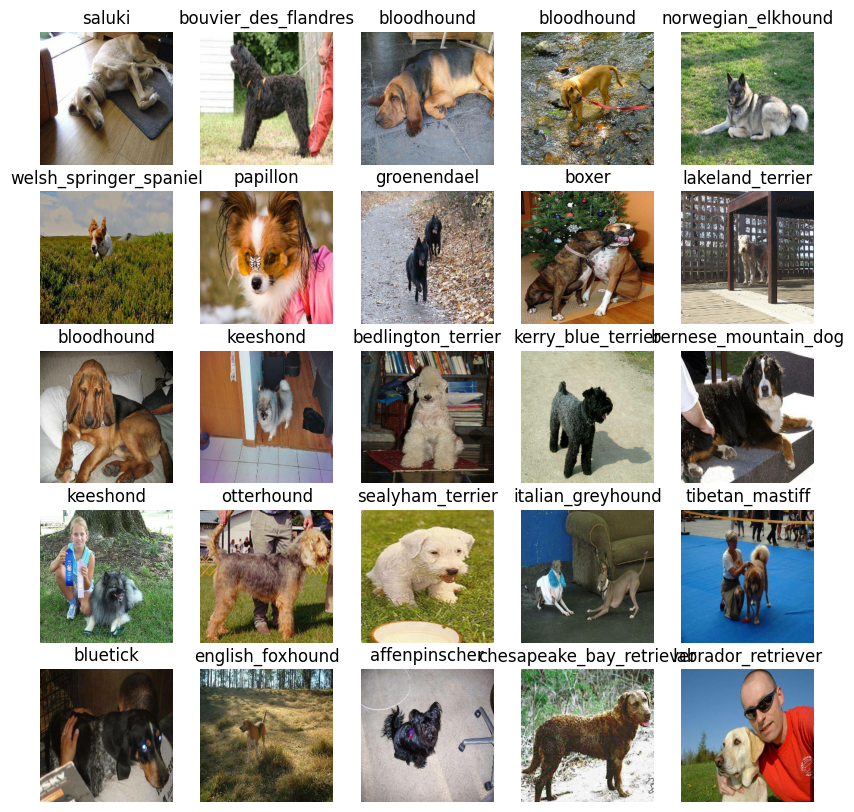

In [63]:

train_images, train_labels = next(train_data.as_numpy_iterator())

#len(train_images), len(train_labels)
# now3 ltes visualize the training batcg

show_25_images(train_images, train_labels)

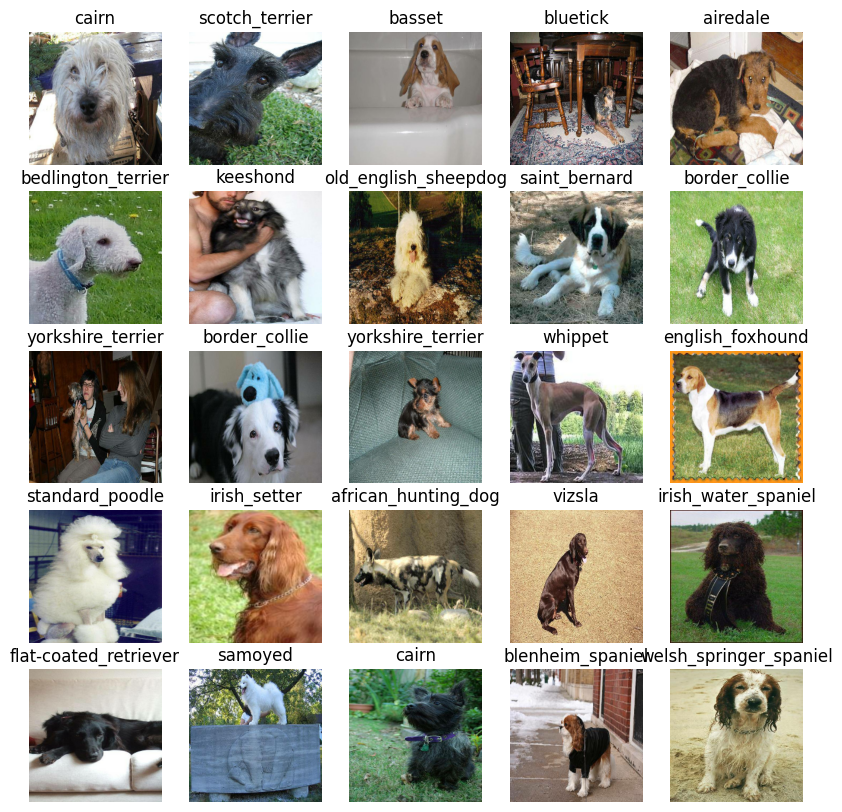

In [64]:
# for validation visualization
val_images, val_labels = next(val_data.as_numpy_iterator())

#len(train_images), len(train_labels)
# now3 ltes visualize the training batcg

show_25_images(val_images, val_labels)

## building a model
before we build the model there are few thins we need to define :
* the input shape(our images shape, in the form of tensors ) to our model
* the output shape (image labels, in the form of tensors ) of our model.
* the URL of the model we want to use
https://www.kaggle.com/models/google/mobilenet-v2/tensorFlow2/130-224-classification/1?tfhub-redirect=true

In [65]:
# setup input shape to the model
INPUT_SHAPE=  [None, IMG_SIZE, IMG_SIZE, 3] # batch , height , widdth, channel
OUTPUT_SHAPE= len(unique_breeds)
MODEL_URL="https://tfhub.dev/google/imagenet/mobilenet_v2_130_224/classification/4"

In [66]:
unique_breeds

array(['affenpinscher', 'afghan_hound', 'african_hunting_dog', 'airedale',
       'american_staffordshire_terrier', 'appenzeller',
       'australian_terrier', 'basenji', 'basset', 'beagle',
       'bedlington_terrier', 'bernese_mountain_dog',
       'black-and-tan_coonhound', 'blenheim_spaniel', 'bloodhound',
       'bluetick', 'border_collie', 'border_terrier', 'borzoi',
       'boston_bull', 'bouvier_des_flandres', 'boxer',
       'brabancon_griffon', 'briard', 'brittany_spaniel', 'bull_mastiff',
       'cairn', 'cardigan', 'chesapeake_bay_retriever', 'chihuahua',
       'chow', 'clumber', 'cocker_spaniel', 'collie',
       'curly-coated_retriever', 'dandie_dinmont', 'dhole', 'dingo',
       'doberman', 'english_foxhound', 'english_setter',
       'english_springer', 'entlebucher', 'eskimo_dog',
       'flat-coated_retriever', 'french_bulldog', 'german_shepherd',
       'german_short-haired_pointer', 'giant_schnauzer',
       'golden_retriever', 'gordon_setter', 'great_dane',
      

In [67]:
# using keras as its a best API


Now we've got our inputs, outputs and model ready to go. Let's put them together into a Keras deep learning model!

Knowing this, let's create a function which:

* Takes the input shape, output shape and the model we've chosen as parameters.
* Defines the layers in a Keras model in sequential fashion (do this first, then this, then that).
*Compiles the model (says it should be evaluated and improved).
* Builds the model (tells the model the input shape it'll be getting).
* Returns the model.

All of these steps can be found here: https://www.tensorflow.org/guide/keras/overview

In [68]:
# class HubWrapper(tf.keras.layers.Layer):
#     def __init__(self, url):
#         super().__init__()
#         self.hub_layer = hub.KerasLayer(url, trainable=False)

#     def build(self, input_shape):
#         self.hub_layer.build(input_shape)
#         self._trainable = self.hub_layer.trainable
#         self.built = True

#     def call(self, x):
#         return self.hub_layer(x)



In [69]:
import tf_keras as keras

In [70]:
embed= hub.KerasLayer(MODEL_URL)

In [71]:
# mobilenet = hub.load(MODEL_URL)

# Create a function which builds a Keras model
def create_model(input_shape=INPUT_SHAPE, output_shape=OUTPUT_SHAPE, model_url=MODEL_URL):
  print("Building model with:", MODEL_URL)

  # Setup the model layers
  model = keras.Sequential([
    embed, # Layer 1 (input layer)
    keras.layers.Dense(units=OUTPUT_SHAPE,
                          activation="softmax") # Layer 2 (output layer)
  ])

  # Compile the model
  model.compile(
      loss=tf.keras.losses.CategoricalCrossentropy(),
      optimizer=keras.optimizers.Adam(),
      metrics=["accuracy"]
  )

  # Build the model
  model.build(INPUT_SHAPE)

  return model

What's happening here?

## Setting up the model layers
There are two ways to do this in Keras, the functional and sequential API. We've used the sequential.

Which one should you use?

The Keras documentation states the functional API is the way to go for defining complex models but the sequential API (a linear stack of layers) is perfectly fine for getting started, which is what we're doing.

The first layer we use is the model from TensorFlow Hub (hub.KerasLayer(MODEL_URL). So our first layer is actually an entire model (many more layers). This input layer takes in our images and finds patterns in them based on the patterns mobilenet_v2_130_224 has found.

The next layer (tf.keras.layers.Dense()) is the output layer of our model. It brings all of the information discovered in the input layer together and outputs it in the shape we're after, 120 (the number of unique labels we have).

The activation="softmax" parameter tells the output layer, we'd like to assign a probability value to each of the 120 labels somewhere between 0 & 1. The higher the value, the more the model believes the input image should have that label. If we were working on a binary classification problem, we'd use activation="sigmoid".

For more on which activation function to use, see the article Which Loss and Activation Functions Should I Use?

## Compiling the model
This one is best explained with a story.

Let's say you're at the international hill descending championships. Where your start standing on top of a hill and your goal is to get to the bottom of the hill. The catch is you're blindfolded.

Luckily, your friend Adam is standing at the bottom of the hill shouting instructions on how to get down.

At the bottom of the hill there's a judge evaluating how you're doing. They know where you need to end up so they compare how you're doing to where you're supposed to be. Their comparison is how you get scored.

Transferring this to model.compile() terminology:

loss - The height of the hill is the loss function, the models goal is to minimize this, getting to 0 (the bottom of the hill) means the model is learning perfectly.
optimizer - Your friend Adam is the optimizer, he's the one telling you how to navigate the hill (lower the loss function) based on what you've done so far. His name is Adam because the Adam optimizer is a great general which performs well on most models. Other optimizers include RMSprop and Stochastic Gradient Descent.
metrics - This is the onlooker at the bottom of the hill rating how well your perfomance is. Or in our case, giving the accuracy of how well our model is predicting the correct image label.
Building the model
We use model.build() whenever we're using a layer from TensorFlow Hub to tell our model what input shape it can expect.

In this case, the input shape is [None, IMG_SIZE, IMG_SIZE, 3] or [None, 224, 224, 3] or [batch_size, img_height, img_width, color_channels].

Batch size is left as None as this is inferred from the data we pass the model. In our case, it'll be 32 since that's what we've set up our data batches as.

Now we've gone through each section of the function, let's use it to create a model.

We can call summary() on our model to get idea of what our model looks like.


In [72]:
model= create_model()
model.summary()

Building model with: https://tfhub.dev/google/imagenet/mobilenet_v2_130_224/classification/4
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 keras_layer (KerasLayer)    (None, 1001)              5432713   
                                                                 
 dense (Dense)               (None, 120)               120240    
                                                                 
Total params: 5552953 (21.18 MB)
Trainable params: 120240 (469.69 KB)
Non-trainable params: 5432713 (20.72 MB)
_________________________________________________________________


## creating callbacks

callbacks are helper function moel use during training , to check progress or stop training early if the model stops improving.

The two callbacks we're going to add are a TensorBoard callback and an Early Stopping callback.

TensorBoard Callback
TensorBoard helps provide a visual way to monitor the progress of your model during and after training.

It can be used directly in a notebook to track the performance measures of a model such as loss and accuracy.

To set up a TensorBoard callback and view TensorBoard in a notebook, we need to do three things:

1. Load the TensorBoard notebook extension.
2. Create a TensorBoard callback which is able to save logs to a directory and pass it to our model's fit() function.
3. Visualize the our models training logs using the %tensorboard magic function (we'll do this later on).

In [73]:
%load_ext tensorboard

In [74]:
import datetime

In [75]:
# create a function to build tensorboard callback
def create_tensorboard_callback():
  # create a log directory for storing tensorflow logs
  logdir= os.path.join("drive/MyDrive/dog vision/logs", datetime.datetime.now().strftime("%Y%m%d-%H%M%S"))
  return keras.callbacks.TensorBoard(logdir)

- early stopping  callback to prevent the generalization means overfitting of the model .
if a certain evaluating metrics is stopped improving

https://www.tensorflow.org/api_docs/python/tf/keras/callbacks/EarlyStopping

In [76]:
early_stopping= keras.callbacks.EarlyStopping(monitor="val_accuracy",
                                                patience=3)


Training a model (on a subset of data)
Our first model is only going to be trained on 1000 images. Or trained on 800 images and then validated on 200 images, meaning 1000 images total or about 10% of the total data.

We do this to make sure everything is working. And if it is, we can step it up later and train on the entire training dataset.

The final parameter we'll define before training is NUM_EPOCHS (also known as number of epochs).

NUM_EPOCHS defines how many passes of the data we'd like our model to do. A pass is equivalent to our model trying to find patterns in each dog image and see which patterns relate to each label.

If NUM_EPOCHS=1, the model will only look at the data once and will probably score badly because it hasn't a chance to correct itself. It would be like you competing in the international hill descent championships and your friend Adam only being able to give you 1 single instruction to get down the hill.

What's a good value for NUM_EPOCHS?

This one is hard to say. 10 could be a good start but so could 100. This is one of the reasons we created an early stopping callback. Having early stopping setup means if we set NUM_EPOCHS to 100 but our model stops improving after 22 epochs, it'll stop training.

Along with this, let's quickly check if we're still using a GPU.

In [77]:
#check to make the gpu is there
print("GPU", "available" if tf.config.list_physical_devices("GPU") else "not available")

GPU available


In [78]:
NUM_EPOCHS= 100 #@param {type:"slider", min:10, max:100, step:10}

#lets create a function which trains a model
- Create a model using create_model().
- Setup a TensorBoard callback using create_tensorboard_callback() (we do this here so it creates a log directory of the current date and time).
- Call the fit() function on our model passing it the training data, validatation data, number of epochs to train for and the callbacks we'd like to use.
- Return the fitted model.


In [79]:
def train_model():
  """ trains the model and returns the trained version """
  model= create_model()

  tensorboard= create_tensorboard_callback()

  model.fit(x=train_data,
            epochs=NUM_EPOCHS,
            validation_data=val_data,
            validation_freq=1,
            callbacks=[tensorboard, early_stopping])
  return model

### 800/32 = 25 and 200/32= 7 almost

Note: When training a model for the first time, the first epoch will take a while to load compared to the rest. This is because the model is getting ready and the data is being initialised. Using more data will generally take longer, which is why we've started with ~1000 images. After the first epoch, subsequent epochs should take a few seconds.

In [80]:
model= train_model()

Building model with: https://tfhub.dev/google/imagenet/mobilenet_v2_130_224/classification/4
Epoch 1/100
25/25 [==============================] - 178s 7s/step - loss: 4.6081 - accuracy: 0.1037 - val_loss: 3.5873 - val_accuracy: 0.2300
Epoch 2/100
25/25 [==============================] - 4s 161ms/step - loss: 1.6307 - accuracy: 0.6862 - val_loss: 2.1862 - val_accuracy: 0.4500
Epoch 3/100
25/25 [==============================] - 4s 167ms/step - loss: 0.5626 - accuracy: 0.9375 - val_loss: 1.6666 - val_accuracy: 0.5700
Epoch 4/100
25/25 [==============================] - 5s 210ms/step - loss: 0.2426 - accuracy: 0.9887 - val_loss: 1.4651 - val_accuracy: 0.6550
Epoch 5/100
25/25 [==============================] - 4s 158ms/step - loss: 0.1443 - accuracy: 0.9962 - val_loss: 1.4064 - val_accuracy: 0.6700
Epoch 6/100
25/25 [==============================] - 5s 181ms/step - loss: 0.0993 - accuracy: 1.0000 - val_loss: 1.3541 - val_accuracy: 0.6550
Epoch 7/100
25/25 [==============================]

**Question**: It looks like our model might be overfitting (getting far better results on the training set than the validation set), what are some ways to prevent model overfitting? Hint: this may involve searching something like "ways to prevent overfitting in a deep learning model?".

**Note**: Overfitting to begin with is a good thing. It means our model is learning something.

### checking the tensorboard logs
the tensorboard magic function ('%tensorboard') will access the logs directory we created and visualize the content

In [81]:
%tensorboard --logdir drive/MyDrive/dog\ vision/logs

<IPython.core.display.Javascript object>

In [82]:
datetime.datetime.now().strftime("%Y%m%d-%H%M%S")


'20251216-012821'

## Making and evaluating predictions using a trained model
Before we scale up and train on more data, let's see some other ways we can evaluate our model. Because although accuracy is a pretty good indicator of how our model is doing, it would be even better if we could could see it in action.

Making predictions with a trained model is as calling predict() on it and passing it data in the same format the model was trained on.

In [83]:
val_data

<_BatchDataset element_spec=(TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None), TensorSpec(shape=(None, 120), dtype=tf.bool, name=None))>

In [84]:
#make predictions on the validation data
predictions= model.predict(val_data, verbose=1) #verbose is for the progress
predictions

7/7 [==============================] - 1s 118ms/step


array([[7.4027653e-04, 4.1776488e-04, 4.8544365e-03, ..., 4.0135218e-04,
        2.3879978e-04, 6.0695582e-03],
       [5.2879220e-03, 7.1836323e-03, 3.5878826e-02, ..., 9.2486473e-04,
        1.1949322e-02, 3.2359443e-04],
       [2.3461023e-05, 2.2912970e-04, 1.3418503e-04, ..., 1.1303991e-05,
        1.8543654e-04, 4.1503346e-04],
       ...,
       [6.2262411e-06, 1.4888625e-04, 1.3643878e-05, ..., 8.1559256e-06,
        2.4733471e-04, 1.2371299e-05],
       [2.1666957e-02, 3.6648443e-04, 5.5915814e-05, ..., 1.3309236e-04,
        2.9364866e-04, 1.2798724e-02],
       [1.1705360e-04, 2.8258892e-05, 4.9931007e-03, ..., 3.1694402e-03,
        3.8543035e-04, 3.1286698e-05]], dtype=float32)

In [85]:
predictions.shape

(200, 120)

In [86]:
predictions[0]

array([7.4027653e-04, 4.1776488e-04, 4.8544365e-03, 5.3852025e-05,
       8.7986758e-04, 1.9331663e-04, 3.2571774e-02, 4.0798410e-04,
       2.1843824e-05, 5.9348147e-04, 3.3983018e-04, 7.8565165e-05,
       1.5245702e-03, 1.1542259e-05, 1.0073854e-03, 2.0983141e-04,
       2.1557177e-04, 1.7500259e-01, 2.4925690e-05, 4.1883279e-05,
       1.0211297e-03, 1.6331451e-04, 8.4964144e-05, 3.4109823e-04,
       6.7294881e-05, 2.3886941e-03, 1.1597755e-01, 4.5704536e-04,
       6.4086309e-04, 9.3060997e-05, 7.1398150e-05, 2.0557619e-03,
       1.9673283e-04, 3.0964133e-05, 1.5605724e-04, 2.7433004e-02,
       2.5379620e-04, 4.3735630e-04, 1.2808733e-04, 1.8710652e-04,
       5.8768701e-04, 1.5562039e-04, 6.9414556e-05, 1.7902788e-04,
       8.7723420e-05, 3.5149518e-05, 1.3465312e-04, 5.5197923e-04,
       1.7108313e-04, 4.8409423e-05, 6.7979511e-04, 1.4817000e-04,
       2.5160328e-04, 1.9661587e-05, 3.4750320e-04, 1.5064477e-04,
       3.1925293e-04, 1.6389744e-03, 5.2078126e-04, 4.9873941e

In [87]:
len(y_val)

200

In [88]:
len(unique_breeds)

120

so this the probality of each breed, and prediction of the first is the highest probality f our first breed

In [89]:
np.sum(predictions[0])

np.float32(1.0000001)

In [90]:
np.sum(predictions[1])

np.float32(1.0)

using softmax activation our array of numbers are chnaging to 1280
as its multiclass .
Making predictions with our model returns an array with a different value for each label.

In this case, making predictions on the validation data (200 images) returns an array (predictions) of arrays, each containing 120 different values (one for each unique dog breed).

These different values are the probabilities or the likelihood the model has predicted a certain image being a certain breed of dog. The higher the value, the more likely the model thinks a given image is a specific breed of dog.

Let's see how we'd convert an array of probabilities into an actual label.

In [91]:
# first prediction
index=0
print(predictions[index])
print(f"Max value (probability of prediction): {np.max(predictions[index])}") # the max probability value predicted by the model
print(f"Sum: {np.sum(predictions[index])}") # because we used softmax activation in our model, this will be close to 1
print(f"Max index: {np.argmax(predictions[index])}") # the index of where the max value in predictions[0] occurs
print(f"Predicted label: {unique_breeds[np.argmax(predictions[index])]}") # the predicted label

[7.4027653e-04 4.1776488e-04 4.8544365e-03 5.3852025e-05 8.7986758e-04
 1.9331663e-04 3.2571774e-02 4.0798410e-04 2.1843824e-05 5.9348147e-04
 3.3983018e-04 7.8565165e-05 1.5245702e-03 1.1542259e-05 1.0073854e-03
 2.0983141e-04 2.1557177e-04 1.7500259e-01 2.4925690e-05 4.1883279e-05
 1.0211297e-03 1.6331451e-04 8.4964144e-05 3.4109823e-04 6.7294881e-05
 2.3886941e-03 1.1597755e-01 4.5704536e-04 6.4086309e-04 9.3060997e-05
 7.1398150e-05 2.0557619e-03 1.9673283e-04 3.0964133e-05 1.5605724e-04
 2.7433004e-02 2.5379620e-04 4.3735630e-04 1.2808733e-04 1.8710652e-04
 5.8768701e-04 1.5562039e-04 6.9414556e-05 1.7902788e-04 8.7723420e-05
 3.5149518e-05 1.3465312e-04 5.5197923e-04 1.7108313e-04 4.8409423e-05
 6.7979511e-04 1.4817000e-04 2.5160328e-04 1.9661587e-05 3.4750320e-04
 1.5064477e-04 3.1925293e-04 1.6389744e-03 5.2078126e-04 4.9873941e-02
 1.0856111e-03 5.5995588e-05 2.7103934e-03 2.4827426e-05 6.4761739e-04
 1.0547588e-02 2.4427357e-04 2.9074200e-04 6.1193532e-03 3.0737658e-04
 8.418

this means that we gave the first image and the first image gave a prediction for those 120 breeds , and we found the maximum probability of the fist image is for index 103 out of 120 breeds , which is ' soft coated wheaten terrier ' . and if we check the unique breeds we will find the same on 103rd index

In [92]:
unique_breeds[103]

'soft-coated_wheaten_terrier'

In [93]:
np.argmax(predictions[0])

np.int64(17)

In [94]:
# first prediction
index= 42
print(predictions[index])
print(f"Max value (probability of prediction): {np.max(predictions[index])}") # the max probability value predicted by the model
print(f"Sum: {np.sum(predictions[index])}") # because we used softmax activation in our model, this will be close to 1
print(f"Max index: {np.argmax(predictions[index])}") # the index of where the max value in predictions[0] occurs
print(f"Predicted label: {unique_breeds[np.argmax(predictions[index])]}") # the predicted label

[1.22005586e-04 2.78859603e-04 2.43649934e-04 1.83272368e-05
 3.52315628e-03 2.21894021e-04 2.98278115e-04 3.44132725e-03
 1.41267097e-02 7.47916400e-02 9.21122191e-05 6.15191675e-05
 5.42474911e-04 1.10940086e-02 1.03157246e-03 8.01622774e-03
 4.91744140e-05 5.53924707e-04 1.63454999e-04 7.13927147e-04
 9.32603289e-05 3.80397483e-04 6.29262358e-04 1.31344801e-04
 3.02206948e-02 1.22849044e-04 2.80139320e-05 1.39336349e-04
 1.23338425e-04 2.41537666e-04 5.28399360e-05 5.06167125e-04
 7.86271994e-05 2.10397520e-05 1.41280951e-04 6.92678586e-05
 9.77953823e-05 7.30865169e-04 1.07970431e-04 1.80648476e-01
 5.91228949e-04 1.19709359e-04 1.42696388e-02 1.37196221e-05
 3.36706842e-04 3.00163782e-04 4.50851076e-04 5.22618240e-04
 3.92952170e-05 3.60541907e-03 3.26131354e-04 2.84066889e-04
 1.23930094e-03 4.79621720e-03 6.59404759e-05 8.46975949e-04
 7.83023715e-04 1.66443060e-05 1.92528387e-04 2.35892603e-05
 2.14197033e-04 5.25046838e-04 1.83271495e-05 1.28798827e-04
 2.56348430e-04 2.863707

In [95]:
unique_breeds[113]

'walker_hound'

Having this information is great but it would be even better if we could compare a prediction to its true label and original image.

To help us, let's first build a little function to convert prediction probabilities into predicted labels.

**Note:** Prediction probabilities are also known as confidence levels.

In [96]:
# turn probabilities into their respected labels
def get_pred_label(prediction_probabilities):
  """
  Turns an array of prediction probabilities into a label
  """
  return unique_breeds[np.argmax(prediction_probabilities)]

#test for an array
get_pred_label(predictions[81])

'irish_setter'

In [97]:
unique_breeds[np.argmax(predictions[81])]

'irish_setter'

In [98]:
val_data

<_BatchDataset element_spec=(TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None), TensorSpec(shape=(None, 120), dtype=tf.bool, name=None))>

remember, the model hasn't trained on the validation data, during the fit() function, it only used the validation data to evaluate itself. So we can use the validation images to visually compare our models predictions with the validation labels.

Since our validation data (val_data) is in batch form, to get a list of validation images and labels, we'll have to unbatch it (using unbatch()) and then turn it into an iterator using as_numpy_iterator().

In [99]:
images_=[]
labels_=[]

#loop through unbatched data
for image, label in val_data.unbatch().as_numpy_iterator():
  images_.append(image)
  labels_.append(label)

In [100]:
images_[0],labels_[0]

(array([[[0.29599646, 0.43284872, 0.3056691 ],
         [0.26635826, 0.32996926, 0.22846507],
         [0.31428418, 0.27701408, 0.22934894],
         ...,
         [0.77614343, 0.82320225, 0.8101595 ],
         [0.81291157, 0.8285351 , 0.8406944 ],
         [0.8209297 , 0.8263737 , 0.8423668 ]],
 
        [[0.2344871 , 0.31603682, 0.19543913],
         [0.3414841 , 0.36560842, 0.27241898],
         [0.45016077, 0.40117094, 0.33964607],
         ...,
         [0.7663987 , 0.8134138 , 0.81350833],
         [0.7304248 , 0.75012016, 0.76590735],
         [0.74518913, 0.76002574, 0.7830809 ]],
 
        [[0.30157745, 0.3082587 , 0.21018331],
         [0.2905954 , 0.27066195, 0.18401104],
         [0.4138316 , 0.36170745, 0.2964005 ],
         ...,
         [0.79871625, 0.8418535 , 0.8606443 ],
         [0.7957738 , 0.82859945, 0.8605655 ],
         [0.75181633, 0.77904975, 0.8155256 ]],
 
        ...,
 
        [[0.9746779 , 0.9878955 , 0.9342279 ],
         [0.99153054, 0.99772066, 0.94278

In [101]:
# so our original data was
get_pred_label(labels_[0])

'cairn'

In [102]:
get_pred_label(predictions[0])

'border_terrier'

In [103]:
# means our model got the prediction wrong and thats what we need to visualize

In [104]:
def unbatchify(data):
  """
  Takes a batched dataset of (image, label) Tensors and returns separate arrays
  of images and labels.
  """
  images = []
  labels = []
  # Loop through unbatched data
  for image, label in data.unbatch().as_numpy_iterator():
    images.append(image)
    labels.append(unique_breeds[np.argmax(label)])
  return images, labels

# Unbatchify the validation data
val_images, val_labels = unbatchify(val_data)
val_images[0], val_labels[0]



(array([[[0.29599646, 0.43284872, 0.3056691 ],
         [0.26635826, 0.32996926, 0.22846507],
         [0.31428418, 0.27701408, 0.22934894],
         ...,
         [0.77614343, 0.82320225, 0.8101595 ],
         [0.81291157, 0.8285351 , 0.8406944 ],
         [0.8209297 , 0.8263737 , 0.8423668 ]],
 
        [[0.2344871 , 0.31603682, 0.19543913],
         [0.3414841 , 0.36560842, 0.27241898],
         [0.45016077, 0.40117094, 0.33964607],
         ...,
         [0.7663987 , 0.8134138 , 0.81350833],
         [0.7304248 , 0.75012016, 0.76590735],
         [0.74518913, 0.76002574, 0.7830809 ]],
 
        [[0.30157745, 0.3082587 , 0.21018331],
         [0.2905954 , 0.27066195, 0.18401104],
         [0.4138316 , 0.36170745, 0.2964005 ],
         ...,
         [0.79871625, 0.8418535 , 0.8606443 ],
         [0.7957738 , 0.82859945, 0.8605655 ],
         [0.75181633, 0.77904975, 0.8155256 ]],
 
        ...,
 
        [[0.9746779 , 0.9878955 , 0.9342279 ],
         [0.99153054, 0.99772066, 0.94278

In [105]:
get_pred_label(val_labels[0])

'affenpinscher'

Now we'hve got ways to get:

1. Prediction labels

2.   Validation labels (truth labels)
3. Validation images



Let's make some functions to make these all a bit more visualize.

More specifically, we want to be able to view an image, its predicted label and its actual label (true label).

The first function we'll create will:

- Take an array of prediction probabilities, an array of truth labels, an array of images and an integer.
- Convert the prediction probabilities to a predicted label.
- Plot the predicted label, its predicted probability, the truth label and target image on a single plot.

In [106]:
def plot_pred(prediction_probabilities, labels, images, n=1):
  """
  View the prediction, ground truth label and image for sample n
  """
  pred_prob, true_label, image = prediction_probabilities[n], labels[n], images[n]
  pred_label= get_pred_label(pred_prob)

  plt.figure(figsize=(5,5))
  plt.imshow(image)
  plt.xticks([])
  plt.yticks([])
    # Change the color of the title depending on if the prediction is right or wrong
  if pred_label == true_label:
    color = "green"
  else:
    color = "red"
  #chnage plot tile to be predicted probabilty of predicrtion and truth label
  plt.title("{} {:2.0f}% ({})".format(pred_label,
                                      np.max(pred_prob)*100,
                                      true_label),
                                      color=color)


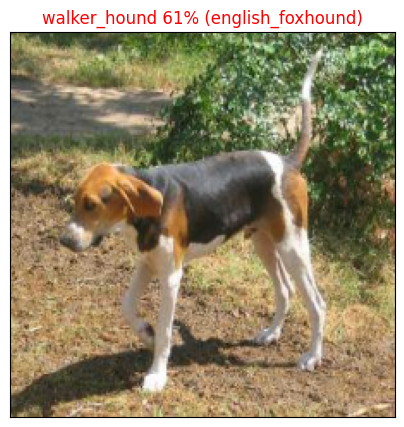

In [107]:
# View an example prediction, original image and truth label
plot_pred(prediction_probabilities=predictions,
          labels=val_labels,
          images=val_images,n=42)

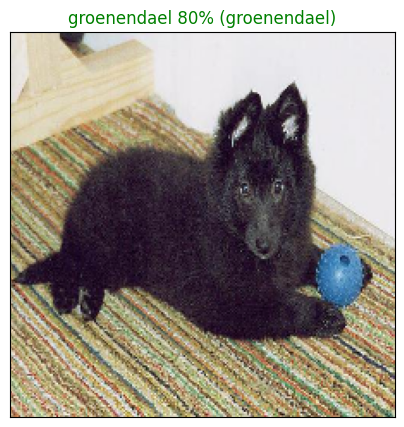

In [108]:
plot_pred(prediction_probabilities=predictions,
          labels=val_labels,
          images=val_images,n=77)

Nice! Making functions to help visual your models results are really helpful in understanding how your model is doing.

Since we're working with a multi-class problem (120 different dog breeds), it would also be good to see what other guesses our model is making. More specifically, if our model predicts a certain label with 24% probability, what else did it predict?

Let's build a function to demonstrate. The function will:

- Take an input of a prediction probabilities array, a ground truth labels array and an integer.
- Find the predicted label using get_pred_label().
- Find the top 10:
- Prediction probabilities indexes
- Prediction probabilities values
- Prediction labels
- Plot the top 10 prediction probability values and labels, coloring the true label green.

In [109]:
def plot_pred_conf(prediction_probabilities, labels, n=1):
  """
  Plots the top 10 highest prediction confidences along with
  the truth label for sample n.
  """
  pred_prob, true_label = prediction_probabilities[n], labels[n]

  # Get the predicted label
  pred_label = get_pred_label(pred_prob)

  # Find the top 10 prediction confidence indexes
  top_10_pred_indexes = pred_prob.argsort()[-10:][::-1]
  # Find the top 10 prediction confidence values
  top_10_pred_values = pred_prob[top_10_pred_indexes]
  # Find the top 10 prediction labels
  top_10_pred_labels = unique_breeds[top_10_pred_indexes]

  # Setup plot
  top_plot = plt.bar(np.arange(len(top_10_pred_labels)),
                     top_10_pred_values,
                     color="grey")
  plt.xticks(np.arange(len(top_10_pred_labels)),
             labels=top_10_pred_labels,
             rotation="vertical")

  # Change color of true label
  if np.isin(true_label, top_10_pred_labels):
    top_plot[np.argmax(top_10_pred_labels == true_label)].set_color("green")
  else:
    pass

In [110]:
predictions[0].argsort()[-10:][::-1] # thsi si the top 10 indeces of prediction 0

array([ 17, 109,  26,  70, 103,  59, 102,  73,   6, 106])

In [111]:
predictions[0].max()

np.float32(0.17500259)

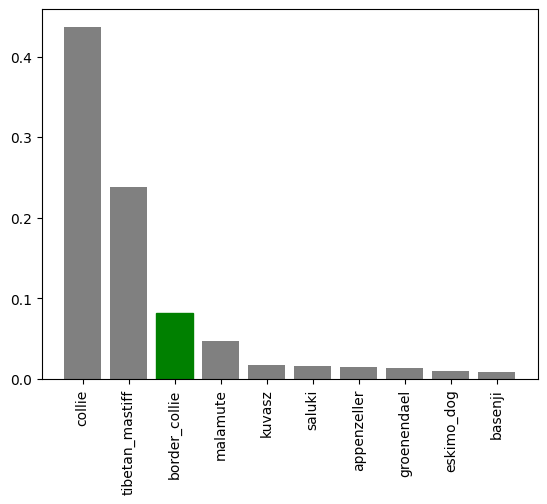

In [112]:
plot_pred_conf(prediction_probabilities=predictions,
               labels=val_labels,
               n=9)

so it predicted collie but in truth it was border_collie

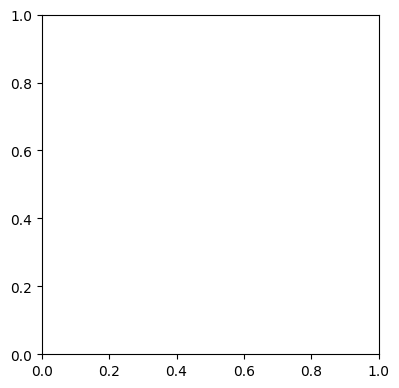

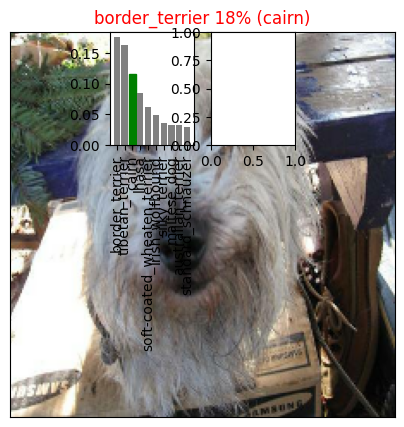

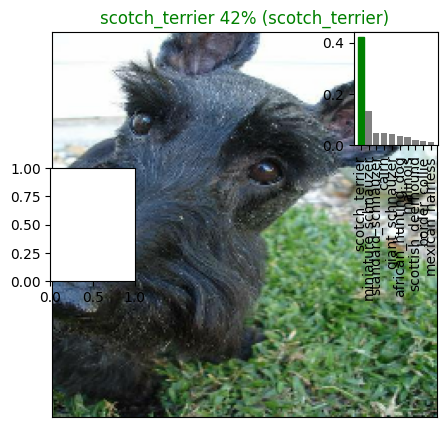

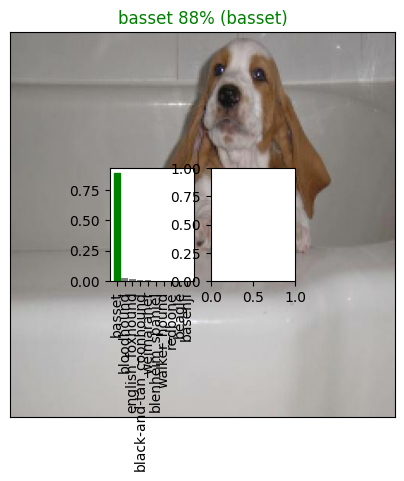

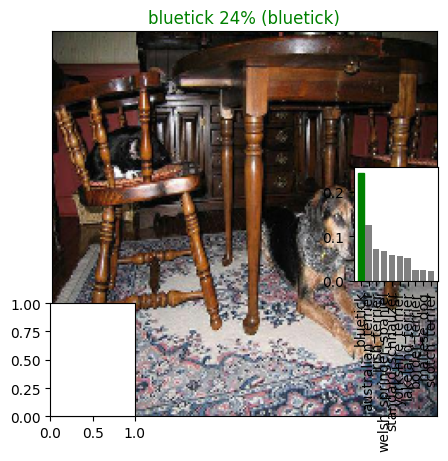

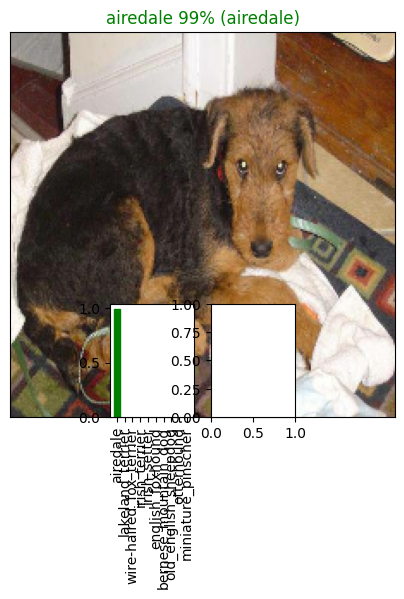

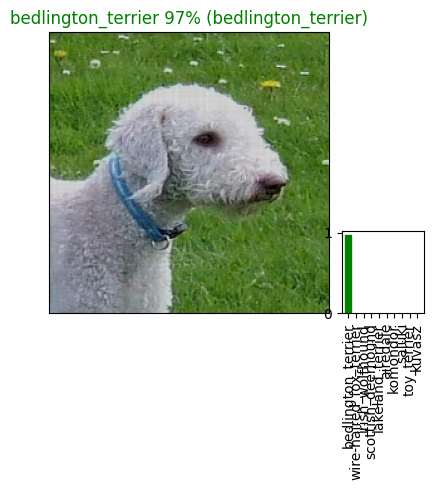

In [113]:
# Let's check a few predictions and their different values
# Let's check a few predictions and their different values
i_multiplier = 0
num_rows = 3
num_cols = 2
num_images = num_rows*num_cols
plt.figure(figsize=(5*2*num_cols, 5*num_rows))
for i in range(num_images):
  plt.subplot(num_rows, 2*num_cols, 2*i+1)
  plot_pred(prediction_probabilities=predictions,
            labels=val_labels,
            images=val_images,
            n=i+i_multiplier)
  plt.subplot(num_rows, 2*num_cols, 2*i+2)
  plot_pred_conf(prediction_probabilities=predictions,
                labels=val_labels,
                n=i+i_multiplier)
plt.tight_layout(h_pad=1.0)
plt.show()

## Saving and reloading a model
After training a model, it's a good idea to save it. Saving it means you can share it with colleagues, put it in an application and more importantly, won't have to go through the potentially expensive step of retraining it.

The format of an entire saved Keras model is h5. So we'll make a function which can take a model as input and utilise the save() method to save it as a h5 file to a specified directory.

In [114]:
def save_model(model, suffix=None):
  """
  Saves a given model in a models directory and appends a suffix (str)
  for clarity and reuse.
  """
  # Create model directory with current time
  modeldir = os.path.join("drive/MyDrive/dog vision/models",
                          datetime.datetime.now().strftime("%Y%m%d-%H%M%s"))
  model_path = modeldir + "-" + suffix + ".h5" # save format of model
  print(f"Saving model to: {model_path}...")
  model.save(model_path)
  return model_path

If we've got a saved model, we'd like to load it, let's create a function which can take a model path and use the tf.keras.models.load_model() function to load it into the notebook.

Because we're using a component from TensorFlow Hub (hub.KerasLayer) we'll have to pass this as a parameter to the custom_objects parameter.

In [115]:
def load_model(model_path):
  """
  Loads a saved model from a specified path.
  """
  print(f"Loading saved model from: {model_path}")
  model = keras.models.load_model(model_path,
                                     custom_objects={"KerasLayer":hub.KerasLayer})
  return model

In [116]:
# Save our model trained on 1000 images
# save_model(model, suffix="1000-images-Adam")

Saving model to: drive/MyDrive/dog vision/models/20251216-01281765848507-1000-images-Adam.h5...


/usr/local/lib/python3.12/dist-packages/tf_keras/src/engine/training.py:3098: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native TF-Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


'drive/MyDrive/dog vision/models/20251216-01281765848507-1000-images-Adam.h5'

In [117]:
# Load our model trained on 1000 images
model_1000_images = load_model('drive/MyDrive/dog vision/models/20251213-22151765664147-1000-images-Adam.h5')

Loading saved model from: drive/MyDrive/dog vision/models/20251213-22151765664147-1000-images-Adam.h5


Compare the two models (the original one and loaded one). We can do so easily using the evaluate() method.

In [118]:
# Evaluate the pre-saved model
model.evaluate(val_data)

7/7 [==============================] - 1s 148ms/step - loss: 1.2954 - accuracy: 0.6550


[1.2953602075576782, 0.6549999713897705]

In [119]:
# Evaluate the loaded model
model_1000_images.evaluate(val_data)

7/7 [==============================] - 2s 108ms/step - loss: 1.2761 - accuracy: 0.6500


[1.2760623693466187, 0.6499999761581421]

## Training a model (on the full data)

Now we know our model works on a subset of the data, we can start to move forward with training one on the full data.

Above, we saved all of the training filepaths to X and all of the training labels to y. Let's check them out.

In [120]:
# Remind ourselves of the size of the full dataset
len(X), len(y)

(10222, 10222)

In [121]:
X[:10]

['drive/My Drive/dog vision/train/000bec180eb18c7604dcecc8fe0dba07.jpg',
 'drive/My Drive/dog vision/train/001513dfcb2ffafc82cccf4d8bbaba97.jpg',
 'drive/My Drive/dog vision/train/001cdf01b096e06d78e9e5112d419397.jpg',
 'drive/My Drive/dog vision/train/00214f311d5d2247d5dfe4fe24b2303d.jpg',
 'drive/My Drive/dog vision/train/0021f9ceb3235effd7fcde7f7538ed62.jpg',
 'drive/My Drive/dog vision/train/002211c81b498ef88e1b40b9abf84e1d.jpg',
 'drive/My Drive/dog vision/train/00290d3e1fdd27226ba27a8ce248ce85.jpg',
 'drive/My Drive/dog vision/train/002a283a315af96eaea0e28e7163b21b.jpg',
 'drive/My Drive/dog vision/train/003df8b8a8b05244b1d920bb6cf451f9.jpg',
 'drive/My Drive/dog vision/train/0042188c895a2f14ef64a918ed9c7b64.jpg']

In [122]:
y[:10]

[array([False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False,  True, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False]),
 array([False, False, False, False, False, Fal

There we go! We've got over 10,000 images and labels in our training set.

Before we can train a model on these, we'll have to turn them into a data batch.

The beautiful thing is, we can use our `create_data_batches()` function from above which also preprocesses our images for us (thank you past us for writing a helpful function).

In [123]:
# Turn full training data in a data batch
full_data = create_data_batches(X, y)

Creating training data batches...


Our data is in a data batch, all we need now is a model.

And surprise, we've got a function for that too! Let's use create_model() to instantiate another model.

In [124]:
# Instantiate a new model for training on the full dataset
full_model = create_model()

Building model with: https://tfhub.dev/google/imagenet/mobilenet_v2_130_224/classification/4


Since we've made a new model instance, full_model, we'll need some callbacks too.

In [125]:
# TensorBoard callback
full_model_tensorboard = create_tensorboard_callback()

# Early stopping callback
# Note: No validation set when training on all the data, therefore can't monitor validation accruacy
full_model_early_stopping = keras.callbacks.EarlyStopping(monitor="accuracy",
                                                             patience=3)

To monitor the model whilst it trains, we'll load TensorBoard (it should update every 30-seconds or so whilst the model trains).

In [126]:
%tensorboard --logdir drive/MyDrive/dog\ vision/logs

Reusing TensorBoard on port 6006 (pid 9363), started 0:00:15 ago. (Use '!kill 9363' to kill it.)

<IPython.core.display.Javascript object>

**note**-Reusing TensorBoard on port 6006 (pid 1855), started 1:55:46 ago. (Use '!kill 1855' to kill it.)
Note: Since running the cell below will cause the model to train on all of the data (10,000+) images, it may take a fairly long time to get started and finish.

However, thanks to our full_model_early_stopping callback, it'll stop before it starts going too long.

Remember, the first epoch is always the longest as data gets loaded into memory. After it's there, it'll speed up.

In [127]:
# Fit the full model to the full training data
# full_model.fit(x=full_data,
#                epochs=NUM_EPOCHS,
#                callbacks=[full_model_tensorboard,
#                           full_model_early_stopping])

Saving and reloading the full model
Even on a GPU, our full model took a while to train. So it's a good idea to save it.

We can do so using our save_model() function.

Challenge: It may be a good idea to incorporate the save_model() function into a train_model() function. Or look into setting up a checkpoint callback.

In [128]:
# Save model to file
# save_model(full_model, suffix="all-images-Adam")

In [129]:
loaded_full_model = load_model('drive/MyDrive/dog vision/models/20251213-23321765668733-all-images-Adam.h5')

Loading saved model from: drive/MyDrive/dog vision/models/20251213-23321765668733-all-images-Adam.h5


## Making predictions on the test dataset
Since our model has been trained on images in the form of Tensor batches, to make predictions on the test data, we'll have to get it into the same format.

Luckily we created create_data_batches() earlier which can take a list of filenames as input and convert them into Tensor batches.

To make predictions on the test data, we'll:

- Get the test image filenames.
- Convert the filenames into test data batches using create_data_batches() and setting the test_data parameter to True (since there are no labels with the test images).
- Make a predictions array by passing the test data batches to the predict() function.

In [130]:
# Load test image filenames (since we're using os.listdir(), these already have .jpg)
test_path = "drive/MyDrive/dog vision/test/"
test_filenames = [test_path + fname for fname in os.listdir(test_path)]

test_filenames[:10]

['drive/MyDrive/dog vision/test/e241bfdd5cc6154698394905abaa0d76.jpg',
 'drive/MyDrive/dog vision/test/dfdeddf3da8d52c211620eaabd82b773.jpg',
 'drive/MyDrive/dog vision/test/e145bbebb9ad1e740256e460899a6b67.jpg',
 'drive/MyDrive/dog vision/test/dcae38083c0e6a8afe15b6f0703bdefa.jpg',
 'drive/MyDrive/dog vision/test/e75eb1ed7b8e53fec8eb9e03c57153b2.jpg',
 'drive/MyDrive/dog vision/test/dcb9aeaf9f1a5c11e95509376d8788ca.jpg',
 'drive/MyDrive/dog vision/test/e7be7b911a4cba9fdfa4105ec4776370.jpg',
 'drive/MyDrive/dog vision/test/e1f7ec4bd372612f53411026aaabf233.jpg',
 'drive/MyDrive/dog vision/test/e60df508ef9f70f9c556003827827234.jpg',
 'drive/MyDrive/dog vision/test/dd1eddb779b2611cdd42de48ae623a62.jpg']

In [131]:
# How many test images are there?
len(test_filenames)

10357

In [132]:
# Create test data batch
test_data = create_data_batches(test_filenames, test_data=True)

Creating test data batches...


**Note**: Since there are 10,000+ test images, making predictions could take a while, even on a GPU. So beware running the cell below may take up to an hour.

In [133]:
# Make predictions on test data batch using the loaded full model
#test_predictions = loaded_full_model.predict(test_data, verbose=1)

now we can run this to save the predictions and can load it later

In [135]:
# np.savetxt("drive/MyDrive/dog vision/preds_array.csv", test_predictions, delimiter=",")

In [136]:
test_predictions = np.loadtxt("drive/MyDrive/dog vision/preds_array.csv", delimiter=",")

In [137]:
# Check out the test predictions
test_predictions[:10]

array([[7.99597340e-14, 1.69074444e-12, 1.48982660e-13, ...,
        8.29495847e-12, 2.20618019e-17, 1.14052048e-08],
       [4.52603666e-12, 1.21706846e-11, 2.64353244e-11, ...,
        3.35977795e-12, 2.15373364e-09, 2.13062098e-12],
       [8.76219375e-10, 4.07979339e-09, 5.80618942e-10, ...,
        7.21636029e-10, 1.79764134e-10, 3.01618257e-07],
       ...,
       [1.92421547e-11, 6.69689443e-11, 1.44588649e-12, ...,
        2.17686027e-15, 1.49624909e-12, 6.82836898e-14],
       [2.63861611e-12, 6.74954125e-13, 7.18963804e-08, ...,
        5.08046209e-12, 3.87573272e-11, 6.61784538e-09],
       [1.14844271e-11, 5.49743060e-15, 2.39886270e-14, ...,
        5.38731536e-16, 4.71254742e-14, 1.67990934e-11]])

In [138]:
test_predictions.shape

(10357, 120)

means we have 10357 different test images and each one of them has 120 different prediction probabilities.

## Preparing test dataset predictions for Kaggle
Looking at the Kaggle sample submission, it looks like they want the models output probabilities each for label along with the image ID's.

To get the data in this format, we'll:

- Create a pandas DataFrame with an ID column as well as a column for each dog breed.
- Add data to the ID column by extracting the test image ID's from their filepaths.
- Add data (the prediction probabilities) to each of the dog breed columns using the unique_breeds list and the test_predictions list.
- Export the DataFrame as a CSV to submit it to Kaggle.

In [139]:
# Create pandas DataFrame with empty columns
preds_df = pd.DataFrame(columns=["id"] + list(unique_breeds))
preds_df.head()

,id,affenpinscher,afghan_hound,african_hunting_dog,airedale,american_staffordshire_terrier,appenzeller,australian_terrier,basenji,basset,...,toy_poodle,toy_terrier,vizsla,walker_hound,weimaraner,welsh_springer_spaniel,west_highland_white_terrier,whippet,wire-haired_fox_terrier,yorkshire_terrier


In [140]:
# Append test image ID's to predictions DataFrame
test_path = "drive/MyDrive/dog vision/test/"
preds_df["id"] = [os.path.splitext(path)[0] for path in os.listdir(test_path)]
preds_df.head()

,id,affenpinscher,afghan_hound,african_hunting_dog,airedale,american_staffordshire_terrier,appenzeller,australian_terrier,basenji,basset,...,toy_poodle,toy_terrier,vizsla,walker_hound,weimaraner,welsh_springer_spaniel,west_highland_white_terrier,whippet,wire-haired_fox_terrier,yorkshire_terrier
0,e241bfdd5cc6154698394905abaa0d76,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,dfdeddf3da8d52c211620eaabd82b773,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,e145bbebb9ad1e740256e460899a6b67,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,dcae38083c0e6a8afe15b6f0703bdefa,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,e75eb1ed7b8e53fec8eb9e03c57153b2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [141]:
list(unique_breeds)

['affenpinscher',
 'afghan_hound',
 'african_hunting_dog',
 'airedale',
 'american_staffordshire_terrier',
 'appenzeller',
 'australian_terrier',
 'basenji',
 'basset',
 'beagle',
 'bedlington_terrier',
 'bernese_mountain_dog',
 'black-and-tan_coonhound',
 'blenheim_spaniel',
 'bloodhound',
 'bluetick',
 'border_collie',
 'border_terrier',
 'borzoi',
 'boston_bull',
 'bouvier_des_flandres',
 'boxer',
 'brabancon_griffon',
 'briard',
 'brittany_spaniel',
 'bull_mastiff',
 'cairn',
 'cardigan',
 'chesapeake_bay_retriever',
 'chihuahua',
 'chow',
 'clumber',
 'cocker_spaniel',
 'collie',
 'curly-coated_retriever',
 'dandie_dinmont',
 'dhole',
 'dingo',
 'doberman',
 'english_foxhound',
 'english_setter',
 'english_springer',
 'entlebucher',
 'eskimo_dog',
 'flat-coated_retriever',
 'french_bulldog',
 'german_shepherd',
 'german_short-haired_pointer',
 'giant_schnauzer',
 'golden_retriever',
 'gordon_setter',
 'great_dane',
 'great_pyrenees',
 'greater_swiss_mountain_dog',
 'groenendael',


In [142]:
# Add the prediction probabilities to each dog breed column
preds_df[list(unique_breeds)] = test_predictions
preds_df.head()

,id,affenpinscher,afghan_hound,african_hunting_dog,airedale,american_staffordshire_terrier,appenzeller,australian_terrier,basenji,basset,...,toy_poodle,toy_terrier,vizsla,walker_hound,weimaraner,welsh_springer_spaniel,west_highland_white_terrier,whippet,wire-haired_fox_terrier,yorkshire_terrier
0,e241bfdd5cc6154698394905abaa0d76,7.995973e-14,1.690744e-12,1.489827e-13,6.238790e-14,1.371124e-13,2.764387e-15,2.359135e-12,2.631777e-14,1.311826e-14,...,3.515396e-12,8.509969e-13,1.799153e-12,2.372860e-14,1.787636e-16,6.606194e-16,6.465059e-17,8.294958e-12,2.206180e-17,1.140520e-08
1,dfdeddf3da8d52c211620eaabd82b773,4.526037e-12,1.217068e-11,2.643532e-11,1.551776e-13,8.693758e-10,1.782575e-09,2.245641e-09,1.336146e-04,8.540550e-13,...,8.129353e-11,3.585946e-08,2.337112e-12,1.327371e-12,4.232517e-10,1.242022e-11,3.769441e-11,3.359778e-12,2.153734e-09,2.130621e-12
2,e145bbebb9ad1e740256e460899a6b67,8.762194e-10,4.079793e-09,5.806189e-10,7.972765e-09,6.498974e-11,1.088574e-11,5.234396e-12,2.793466e-13,3.813783e-09,...,2.901694e-09,4.145679e-12,4.709203e-06,1.049960e-09,4.123960e-08,2.845353e-09,5.918761e-11,7.216360e-10,1.797641e-10,3.016183e-07
3,dcae38083c0e6a8afe15b6f0703bdefa,5.566892e-11,1.011763e-02,3.450045e-09,2.689033e-11,1.994579e-08,3.733069e-10,2.284951e-09,3.113256e-12,1.047331e-09,...,4.824197e-08,1.301283e-12,2.615064e-07,2.762973e-07,2.627724e-05,1.614217e-10,2.729699e-13,3.052736e-06,5.024604e-09,7.138478e-08
4,e75eb1ed7b8e53fec8eb9e03c57153b2,2.465694e-14,3.945805e-12,1.076931e-15,3.181570e-15,1.480002e-11,5.270352e-15,3.592121e-15,1.479217e-12,6.824800e-13,...,7.948403e-14,4.784839e-14,7.827444e-14,7.537400e-12,1.042533e-12,7.614391e-15,4.535071e-14,7.712498e-15,1.052039e-17,1.285220e-16


Boom! Let's now export our predictions DataFrame to CSV so we can submit it to Kaggle.

In [143]:
preds_df.to_csv("drive/MyDrive/dog vision/full_submission_1_mobilienetV2_adam.csv",
                 index=False)

## Making predictions on custom images
It's great being able to make predictions on a test dataset already provided for us.

But how could we use our model on our own images?

The premise remains, if we want to make predictions on our own custom images, we have to pass them to the model in the same format the model was trained on.

To do so, we'll:

- Get the filepaths of our own images.
- Turn the filepaths into data batches using create_data_batches(). And since our custom images won't have labels, we set the test_data parameter to True.
- Pass the custom image data batch to our model's predict() method.
- Convert the prediction output probabilities to prediction labels.
- Compare the predicted labels to the custom images.

**Note**: To make predictions on custom images, I've uploaded pictures of my own to a directory located at drive/My Drive/Data/dogs/ (as seen in the cell below). In order to make predictions on your own images, you will have to do something similar.

In [ ]:
#example

In [ ]:
# Get custom image filepaths
custom_path = "drive/MyDrive/dog vision/dogs-custom-images/"
custom_image_paths = [custom_path + fname for fname in os.listdir(custom_path)]

In [ ]:
# Turn custom image into batch (set to test data because there are no labels)
custom_data = create_data_batches(custom_image_paths, test_data=True)

In [ ]:
# Make predictions on the custom data
custom_preds = loaded_full_model.predict(custom_data)

Now we've got some predictions arrays, let's convert them to labels and compare them with each image.

In [ ]:
# Get custom image prediction labels
custom_pred_labels = [get_pred_label(custom_preds[i]) for i in range(len(custom_preds))]
custom_pred_labels

In [ ]:
# Get custom images (our unbatchify() function won't work since there aren't labels)
custom_images = []
# Loop through unbatched data
for image in custom_data.unbatch().as_numpy_iterator():
  custom_images.append(image)

In [ ]:
# Check custom image predictions
plt.figure(figsize=(10, 10))
for i, image in enumerate(custom_images):
  plt.subplot(1, 3, i+1)
  plt.xticks([])
  plt.yticks([])
  plt.title(custom_pred_labels[i])
  plt.imshow(image)